In [2]:
!pip install -U timm
!pip install -U albumentations

In [1]:
import torch
import torchtext
import timm
import albumentations
import cv2

print(f"✅ PyTorch: {torch.__version__}")
print(f"✅ TorchText: {torchtext.__version__}")
print(f"✅ Timm: {timm.__version__}")
print(f"✅ CUDA available: {torch.cuda.is_available()}")

✅ PyTorch: 2.5.1
✅ TorchText: 0.6.0
✅ Timm: 1.0.21
✅ CUDA available: True


In [4]:
import torch
import torchvision
import torchaudio
import torchtext
import timm

print(f"PyTorch: {torch.__version__}")
print(f"TorchText: {torchtext.__version__}")
print(f"Timm: {timm.__version__}")

# Test the import that was failing
from torch.library import get_ctx
print("✓ All imports successful!")

PyTorch: 2.5.1
TorchText: 0.6.0
Timm: 1.0.21
✓ All imports successful!


In [ ]:
pip install torchtext==0.18.0 timm

In [34]:
import torch
import torch.nn as nn
import albumentations as alb
from albumentations.pytorch import ToTensorV2
import timm
import cv2
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
import pandas as pd
import torchtext
from collections import Counter
from torchtext.data.utils import get_tokenizer

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class ImageCaptioner(nn.Module):
  def __init__(self, context_length, vocabulary_size, num_blocks, model_dim, num_heads, prob):
    super().__init__()
    self.cnn_encoder = timm.create_model('efficientnet_b0', pretrained=True)
    test_image = torch.zeros((1, 3, 224, 224))

    with torch.no_grad():
      cnn_output = self.cnn_encoder(test_image)
    in_features = cnn_output.shape[1]
    self.project = nn.Linear(in_features, model_dim)

    self.word_embeddings = nn.Embedding(vocabulary_size, model_dim)
    self.pos_embeddings = nn.Embedding(context_length, model_dim)

    block = nn.TransformerDecoderLayer(model_dim, num_heads, 2 * model_dim, dropout=prob, batch_first=True, norm_first=True)
    self.decoder = nn.TransformerDecoder(block, num_blocks)

    self.vocab_projection = nn.Linear(model_dim, vocabulary_size)

    #self.dropout = nn.Dropout(prob)

  def forward(self, images, true_labels):
    tok_embedded = self.word_embeddings(true_labels)
    B, T = true_labels.shape
    positions = torch.arange(T).to(device)
    pos_embedded = self.pos_embeddings(positions)
    total_embeddings = tok_embedded + pos_embedded
    # total_embeddings = self.dropout(total_embeddings)

    with torch.no_grad():
      encoded_image = self.project(self.cnn_encoder(images)) # Removed .view(B, -1) as timm models typically output features directly

    img_for_attention = torch.unsqueeze(encoded_image, 1)

    attention_mask = generate_square_subsequent_mask(T).to(device)
    block_output = self.decoder(total_embeddings, img_for_attention, tgt_mask=attention_mask) # Changed self.blocks to self.decoder

    vocabulary_vector = self.vocab_projection(block_output)

    return vocabulary_vector

In [35]:
pwd

'C:\\Users\\likit\\Documents\\projects\\image captioning llm'

In [36]:
import os
import pandas as pd
from collections import Counter
from torchtext.data.utils import get_tokenizer
from torchtext.vocab import Vocab

# Set your working directory
os.chdir("C:\\Users\\likit\\Documents\\projects\\image captioning llm")

# Caption file
caption_filename = "C:\\Users\\likit\\Documents\\projects\\image captioning llm\\captions.txt"
missing = '2258277193_586949ec62.jpg'

with open(caption_filename) as captions:
    lines = captions.readlines()

get_caption = {}
all_captions = []

for caption in lines:
    data = caption.rstrip('\n').split('.jpg,')
    img_name = data[0] + '.jpg'
    if img_name == missing:
        continue
    caption_list = get_caption.get(img_name, [])
    caption_list.append(data[1])
    get_caption[img_name] = caption_list
    all_captions.append(data[1])

df = pd.DataFrame(columns=['filename', 'caption'])
df['filename'] = get_caption.keys()
df['caption'] = df['filename'].map(lambda filename: get_caption[filename])

vocab_frequency = Counter()
word_tokenizer = get_tokenizer('basic_english')

for cap in all_captions:
    vocab_frequency.update(word_tokenizer(cap))

# Old torchtext 0.6.0 API - use <unk> instead of <UNKNOWN>
vocabulary = Vocab(vocab_frequency, specials=['<unk>', '<PAD>', '<START>', '<END>'])

print(f"Vocabulary size: {len(vocabulary)}")
print(f"Total captions: {len(all_captions)}")
print(f"Index of <unk>: {vocabulary.stoi['<unk>']}")  # stoi = string to index
print(f"Index of <PAD>: {vocabulary.stoi['<PAD>']}")
print(f"Index of <START>: {vocabulary.stoi['<START>']}")
print(f"Index of <END>: {vocabulary.stoi['<END>']}")

Vocabulary size: 8915
Total captions: 40455
Index of <unk>: 0
Index of <PAD>: 1
Index of <START>: 2
Index of <END>: 3


In [37]:
# Create vocabulary_mapping dictionary from vocabulary
vocabulary_mapping = vocabulary.stoi  # This is a dictionary: word -> index

context_length = 20

class ImageCaptioningDataset(Dataset):
    def __init__(self, split, vocabulary_mapping, word_tokenizer):
        self.df = df
        self.vocabulary_mapping = vocabulary_mapping  # Store the mapping
        self.word_tokenizer = word_tokenizer
        self.img_size = 224
        transformation_list = [alb.Resize(self.img_size, self.img_size)]
        if split == 'training':
            transformation_list.append(alb.HorizontalFlip())
            transformation_list.append(alb.ColorJitter())
        transformation_list.append(alb.Normalize())
        transformation_list.append(ToTensorV2())
        self.transformations = alb.Compose(transformation_list)
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):
        image_filename, captions = self.df.iloc[idx]
        actual_image = cv2.cvtColor(cv2.imread('Images/' + image_filename), cv2.COLOR_BGR2RGB)
        transformed_img = self.transformations(image=actual_image)['image']
        
        encoded_captions = []
        for i, cap in enumerate(captions):
            splitted = self.word_tokenizer(cap)
            
            # Use vocabulary_mapping with .get() to handle unknown words
            integers = [self.vocabulary_mapping.get(word, self.vocabulary_mapping['<unk>']) 
                       for word in splitted]
            
            integers = [2] + integers + [3]
            
            if len(integers) <= context_length:
                pads_to_add = context_length - len(integers)
                integers += [1] * pads_to_add
            else:
                integers = integers[:context_length - 1] + [3]
            
            # Fixed: was 'integer' now 'integers'
            encoded_captions.append(torch.tensor(integers, dtype=torch.long))
        
        # Fixed: torch.randit -> torch.randint
        random_idx = torch.randint(5, (1,)).item()
        
        # Fixed: transfomred_img -> transformed_img
        return transformed_img, encoded_captions[random_idx]

# Create dataset with vocabulary_mapping
training_dataset = ImageCaptioningDataset('training', vocabulary_mapping, word_tokenizer)
training_data = DataLoader(training_dataset, batch_size=32, shuffle=True)

print(f"Dataset created: {len(training_dataset)} samples")

Dataset created: 8091 samples


In [38]:
context_length = 20
vocabulary_size = len(vocabulary)
num_blocks = 6
model_dim = 512
num_heads = 16
prob = 0.5

model = ImageCaptioner(context_length, vocabulary_size, num_blocks, model_dim, num_heads, prob).to(device)

for layers in model.cnn_encoder.parameters():
    layers.requires_grad = False

loss_function = nn.CrossEntropyLoss()

optimizer = torch.optim.AdamW(model.parameters(), lr=1e-5)







In [39]:
def generate_square_subsequent_mask(sz):
    """Generate a square mask for the sequence."""
    mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
    mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
    return mask

num_epochs = 20
num_iterations = 0

for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    epoch_loss = 0
    
    for images, captions in training_data:
        images, captions = images.to(device), captions.to(device)
        
        # Get batch size, sequence length, vocab size
        B = images.size(0)
        T = captions.size(1)
        
        # Zero gradients
        optimizer.zero_grad()  # Fixed: was missing
        
        model_prediction = model(images, captions)
        V = model_prediction.size(-1)  # Vocabulary size
        
        model_prediction = model_prediction.view(B * T, V)
        
        loss = loss_function(model_prediction, captions.view(B * T))
        loss.backward()  # Fixed: was loss.backwards()
        
        nn.utils.clip_grad_norm_(model.parameters(), 20)  # Fixed: was model.parameter()
        optimizer.step()  # Fixed: was optimzer.step()
        
        epoch_loss += loss.item()
        
        if num_iterations % 100 == 0:
            print(f"Iteration {num_iterations}, Loss: {loss.item():.4f}")
        
        num_iterations += 1
    
    avg_loss = epoch_loss / len(training_data)
    print(f"Epoch {epoch+1}/{num_epochs}, Average Loss: {avg_loss:.4f}")

Iteration 0, Loss: 11.1249
Iteration 100, Loss: 4.8773
Iteration 200, Loss: 3.7794
Epoch 1/20, Average Loss: 4.9590
Iteration 300, Loss: 2.7988
Iteration 400, Loss: 2.5597
Iteration 500, Loss: 2.5777
Epoch 2/20, Average Loss: 2.8131
Iteration 600, Loss: 2.3361
Iteration 700, Loss: 2.1824
Epoch 3/20, Average Loss: 2.2441
Iteration 800, Loss: 2.0461
Iteration 900, Loss: 1.8045
Iteration 1000, Loss: 2.1548
Epoch 4/20, Average Loss: 1.9162
Iteration 1100, Loss: 1.9056
Iteration 1200, Loss: 1.4325
Epoch 5/20, Average Loss: 1.6892
Iteration 1300, Loss: 1.5659
Iteration 1400, Loss: 1.5468
Iteration 1500, Loss: 1.6154
Epoch 6/20, Average Loss: 1.5245
Iteration 1600, Loss: 1.3393
Iteration 1700, Loss: 1.5655
Epoch 7/20, Average Loss: 1.3662
Iteration 1800, Loss: 1.2691
Iteration 1900, Loss: 1.1343
Iteration 2000, Loss: 0.9817
Epoch 8/20, Average Loss: 1.2539
Iteration 2100, Loss: 1.2860
Iteration 2200, Loss: 0.9984
Epoch 9/20, Average Loss: 1.1547
Iteration 2300, Loss: 1.3719
Iteration 2400, Lo

In [40]:
torch.save(model.state_dict(), 'weights.pt')
print("Model weights saved as 'weights.pt' in the current directory")

Model weights saved as 'weights.pt' in the current directory


In [41]:
# model.load_state_dict(torch.load('/content/hella epochs.pt'))

Testing on 10 random images...

1. Image: 449352117_63c359c6e7.jpg
   Caption: No caption generated

2. Image: 1490213660_9ea45550cf.jpg
   Caption: No caption generated

3. Image: 3589368949_0866846949.jpg
   Caption: No caption generated

4. Image: 1144288288_e5c9558b6a.jpg
   Caption: No caption generated

5. Image: 514431934_9cf78f05a9.jpg
   Caption: No caption generated

6. Image: 3342309960_c694b2cce9.jpg
   Caption: No caption generated

7. Image: 47870024_73a4481f7d.jpg
   Caption: No caption generated

8. Image: 2446315531_7c9704eec0.jpg
   Caption: No caption generated

9. Image: 390992102_67fa31b22f.jpg
   Caption: No caption generated

10. Image: 3301744710_b51280eb56.jpg
   Caption: No caption generated



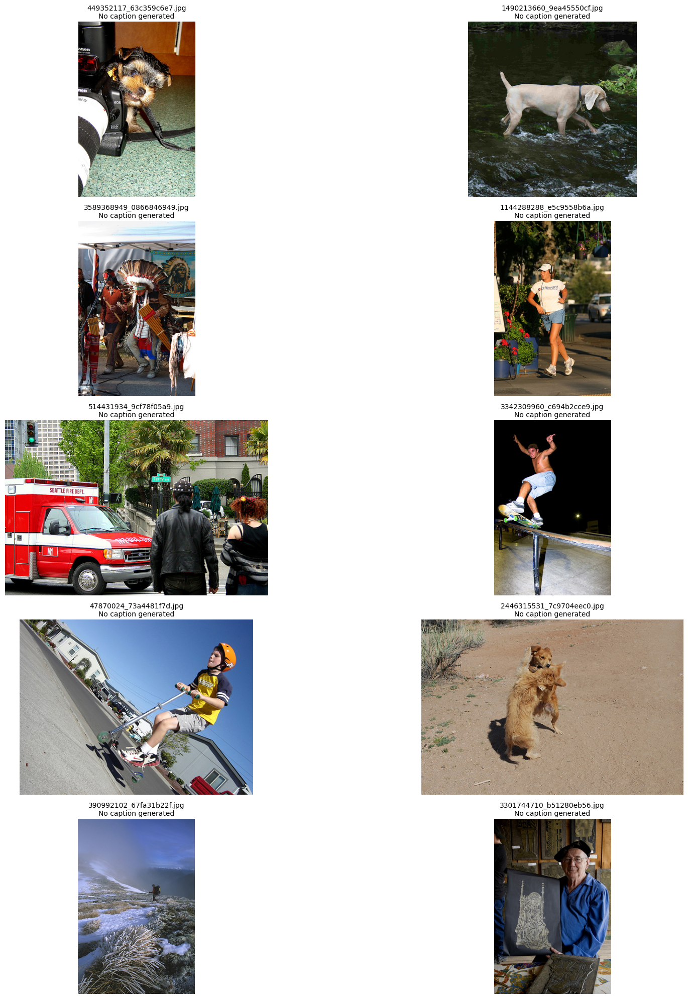

✅ Results saved as 'test_results_fixed.png'


In [45]:
import torch
import cv2
import random
import os
import matplotlib.pyplot as plt
import albumentations as alb
from albumentations.pytorch import ToTensorV2

# Define the transform for testing
test_transform = alb.Compose([
    alb.Resize(224, 224),
    alb.Normalize(),
    ToTensorV2()
])

def generate_caption(model, image_path, vocabulary, word_tokenizer, transform, device, max_length=20):
    model.eval()
    
    # Load and transform image
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    transformed = transform(image=image)['image'].unsqueeze(0).to(device)
    
    # Start with <START> token (index 2)
    caption_indices = [vocabulary.stoi['<START>']]
    
    with torch.no_grad():
        for _ in range(max_length):
            # Create caption tensor
            caption_tensor = torch.tensor([caption_indices]).to(device)
            
            # Get model prediction
            output = model(transformed, caption_tensor)
            
            # Get the predicted token for the NEXT position
            next_token_logits = output[0, len(caption_indices) - 1, :]  # Get logits for current position
            next_token = next_token_logits.argmax().item()
            
            # Stop if we predict <END> token
            if next_token == vocabulary.stoi['<END>']:
                break
            
            # Skip if model predicts <START> or <PAD>
            if next_token == vocabulary.stoi['<START>'] or next_token == vocabulary.stoi['<PAD>']:
                break
                
            caption_indices.append(next_token)
    
    # Convert indices to words (skip <START> token)
    words = []
    for idx in caption_indices[1:]:  # Skip the first <START> token
        word = vocabulary.itos[idx]
        # Skip special tokens in output
        if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
            words.append(word)
    
    caption = ' '.join(words) if words else "No caption generated"
    return caption, image

# Get all images from directory
image_dir = r"C:\Users\likit\Documents\projects\image captioning llm\Images"
all_images = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Select 10 random images
random_images = random.sample(all_images, min(10, len(all_images)))

print(f"Testing on {len(random_images)} random images...\n")

# Generate captions and display
plt.figure(figsize=(20, 20))

for idx, img_name in enumerate(random_images):
    img_path = os.path.join(image_dir, img_name)
    
    # Generate caption
    caption, image = generate_caption(model, img_path, vocabulary, word_tokenizer, test_transform, device)
    
    # Display image with caption
    plt.subplot(5, 2, idx + 1)
    plt.imshow(image)
    plt.title(f"{img_name}\n{caption}", fontsize=10, wrap=True)
    plt.axis('off')
    
    print(f"{idx+1}. Image: {img_name}")
    print(f"   Caption: {caption}\n")

plt.tight_layout()
plt.savefig('test_results_fixed.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ Results saved as 'test_results_fixed.png'")

In [46]:
def generate_caption_debug(model, image_path, vocabulary, word_tokenizer, transform, device, max_length=20):
    model.eval()
    
    # Load and transform image
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    transformed = transform(image=image)['image'].unsqueeze(0).to(device)
    
    # Start with <START> token (index 2)
    caption_indices = [vocabulary.stoi['<START>']]
    
    print(f"\nStarting caption generation...")
    print(f"<START> token index: {vocabulary.stoi['<START>']}")
    
    with torch.no_grad():
        for step in range(max_length):
            # Create caption tensor
            caption_tensor = torch.tensor([caption_indices]).to(device)
            
            # Get model prediction
            output = model(transformed, caption_tensor)
            
            # Get the predicted token for the NEXT position
            next_token_logits = output[0, -1, :]  # Get last position logits
            
            # Get top 5 predictions
            top5_values, top5_indices = torch.topk(next_token_logits, 5)
            print(f"\nStep {step + 1}:")
            print(f"  Top 5 predictions:")
            for i, (val, idx) in enumerate(zip(top5_values, top5_indices)):
                word = vocabulary.itos[idx.item()]
                print(f"    {i+1}. {word} (index: {idx.item()}, logit: {val.item():.4f})")
            
            next_token = next_token_logits.argmax().item()
            predicted_word = vocabulary.itos[next_token]
            print(f"  Selected: {predicted_word} (index: {next_token})")
            
            # Stop if we predict <END> token
            if next_token == vocabulary.stoi['<END>']:
                print("  -> Stopping: <END> token predicted")
                break
            
            # Check for problematic tokens
            if next_token == vocabulary.stoi['<START>']:
                print("  -> Stopping: <START> token predicted (model error)")
                break
            if next_token == vocabulary.stoi['<PAD>']:
                print("  -> Stopping: <PAD> token predicted (model error)")
                break
                
            caption_indices.append(next_token)
    
    # Convert indices to words (skip <START> token)
    words = []
    for idx in caption_indices[1:]:
        word = vocabulary.itos[idx]
        if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
            words.append(word)
    
    caption = ' '.join(words) if words else "No caption generated"
    print(f"\nFinal caption: {caption}")
    print(f"Caption indices: {caption_indices}")
    
    return caption, image

# Test on ONE image first to debug
test_img = random.choice(all_images)
test_path = os.path.join(image_dir, test_img)
print(f"Testing image: {test_img}")

caption, img = generate_caption_debug(model, test_path, vocabulary, word_tokenizer, test_transform, device)

Testing image: 213216174_0632af65a2.jpg

Starting caption generation...
<START> token index: 2

Step 1:
  Top 5 predictions:
    1. <START> (index: 2, logit: 24.8658)
    2. kids (index: 178, logit: 8.7957)
    3. crossing (index: 630, logit: 8.6790)
    4. plays (index: 117, logit: 8.2605)
    5. basketball (index: 157, logit: 8.2597)
  Selected: <START> (index: 2)
  -> Stopping: <START> token predicted (model error)

Final caption: No caption generated
Caption indices: [2]


Testing on 10 random images with fixed inference...

1. Image: 2952320230_26601173be.jpg
   Caption: children children children children children children children children children children children children children children children children children children children children

2. Image: 3323498985_fd9d2803fd.jpg
   Caption: children children children children children children children children children children children children children children children children children children children children

3. Image: 3150659152_2ace03690b.jpg
   Caption: crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing

4. Image: 3326588088_172d1b2584.jpg
   Caption: crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing crossing

5. Image: 3130093622_362f32f2bb

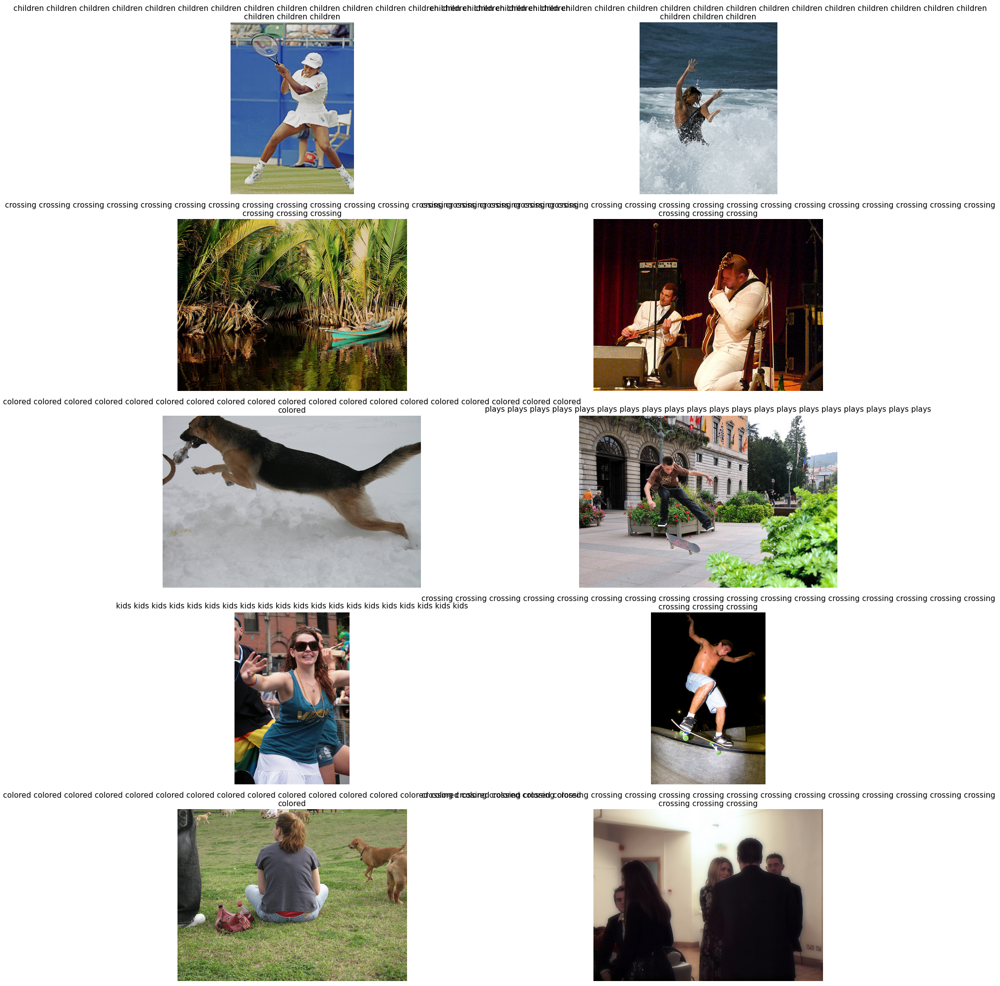

✅ Results saved as 'test_results_final.png'


In [47]:
def generate_caption_fixed(model, image_path, vocabulary, word_tokenizer, transform, device, max_length=20):
    model.eval()
    
    # Load and transform image
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    transformed = transform(image=image)['image'].unsqueeze(0).to(device)
    
    # Start with <START> token (index 2)
    caption_indices = [vocabulary.stoi['<START>']]
    
    # Get special token indices to mask
    special_tokens = {
        vocabulary.stoi['<START>'],
        vocabulary.stoi['<PAD>'],
        vocabulary.stoi.get('<unk>', 0)
    }
    
    with torch.no_grad():
        for step in range(max_length):
            # Create caption tensor
            caption_tensor = torch.tensor([caption_indices]).to(device)
            
            # Get model prediction
            output = model(transformed, caption_tensor)
            
            # Get the predicted token for the NEXT position
            next_token_logits = output[0, -1, :].clone()
            
            # MASK OUT special tokens by setting their logits to very negative value
            for special_idx in special_tokens:
                next_token_logits[special_idx] = -float('inf')
            
            # Now get the best token (excluding special tokens)
            next_token = next_token_logits.argmax().item()
            
            # Stop if we predict <END> token
            if next_token == vocabulary.stoi['<END>']:
                break
                
            caption_indices.append(next_token)
    
    # Convert indices to words (skip <START> token)
    words = []
    for idx in caption_indices[1:]:
        word = vocabulary.itos[idx]
        if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
            words.append(word)
    
    caption = ' '.join(words) if words else "No caption generated"
    return caption, image

# Test on 10 random images with fixed function
random_images = random.sample(all_images, min(10, len(all_images)))

print(f"Testing on {len(random_images)} random images with fixed inference...\n")

# Generate captions and display
plt.figure(figsize=(20, 20))

for idx, img_name in enumerate(random_images):
    img_path = os.path.join(image_dir, img_name)
    
    # Generate caption
    caption, image = generate_caption_fixed(model, img_path, vocabulary, word_tokenizer, test_transform, device)
    
    # Display image with caption
    plt.subplot(5, 2, idx + 1)
    plt.imshow(image)
    plt.title(f"{caption}", fontsize=11, wrap=True)
    plt.axis('off')
    
    print(f"{idx+1}. Image: {img_name}")
    print(f"   Caption: {caption}\n")

plt.tight_layout()
plt.savefig('test_results_final.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ Results saved as 'test_results_final.png'")

1. 3724718895_bd03f4a4dc.jpg: kids kids kids sticking shirt shirt float shirts dogs dogs its its mouth mouth kneeling play play something something docks
2. 2533642917_a5eace85e6.jpg: they kid kid plays plays clothing clothing street street street hold jeans jeans she . . . sticks swimming swimming
3. 3196995975_3e38eabf01.jpg: kids kids german biker biker celebrating laughs camera camera piece funny area area shirt shirt one one grass grass grass
4. 3677954655_df4c0845aa.jpg: crossing a a a wall wall wall be poles smoke dog dog dog air air teenage phone full overpass displays
5. 3726170067_094cc1b7e5.jpg: crossing a a a wall wall wall inflatable plays plays tent lawn fallen looks looks sleeping signature bathing drum smiles
6. 3580741947_cc64a83648.jpg: crossing greyhounds of of of low back back back dress stroller smoking six him him spinning jeans jeans trampoline her
7. 2510020918_b2ca0fb2aa.jpg: crossing crossing cowgirl tan tan on on on nearby nearby ramp ramp bag bats skateboard

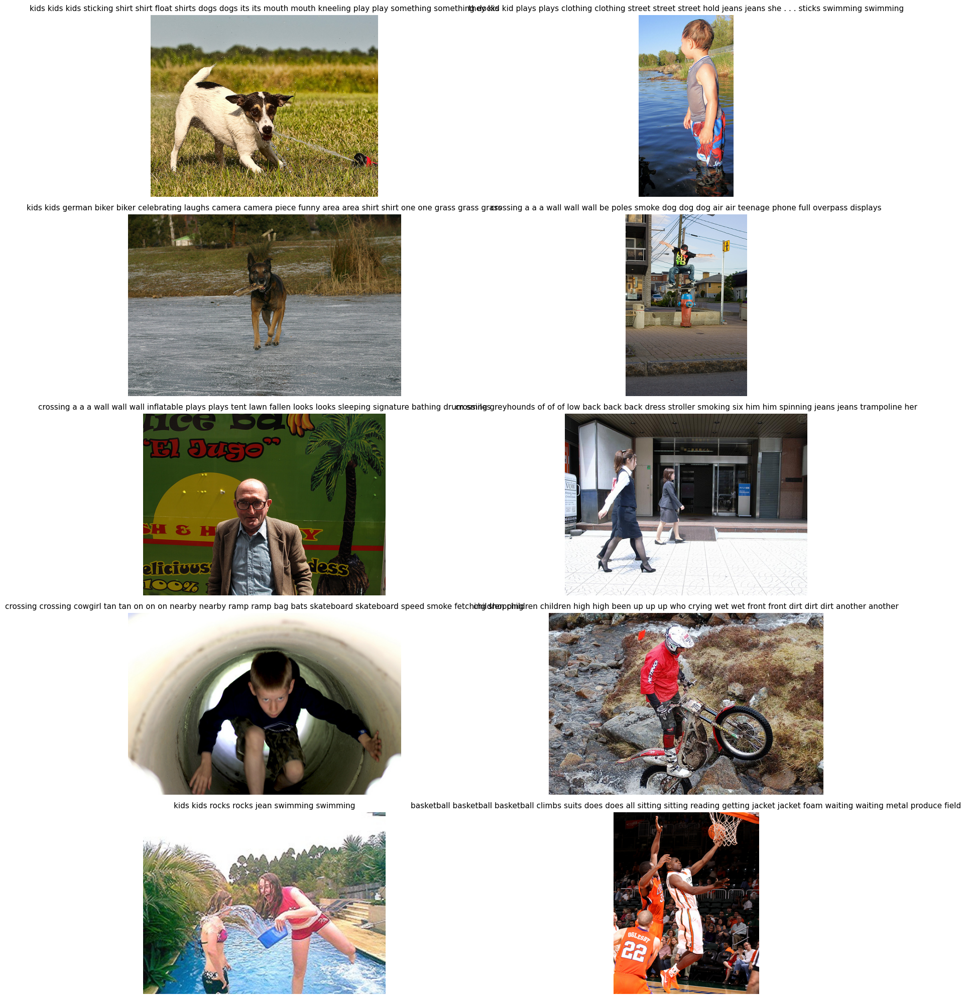

In [49]:
def generate_caption_best(model, image_path, vocabulary, word_tokenizer, transform, device, max_length=20, temperature=0.7, repetition_penalty=1.5):
    model.eval()
    
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    transformed = transform(image=image)['image'].unsqueeze(0).to(device)
    
    caption_indices = [vocabulary.stoi['<START>']]
    
    special_tokens = {
        vocabulary.stoi['<START>'],
        vocabulary.stoi['<PAD>'],
        vocabulary.stoi.get('<unk>', 0)
    }
    
    with torch.no_grad():
        for step in range(max_length):
            caption_tensor = torch.tensor([caption_indices]).to(device)
            output = model(transformed, caption_tensor)
            next_token_logits = output[0, -1, :].clone()
            
            # Mask special tokens
            for special_idx in special_tokens:
                next_token_logits[special_idx] = -float('inf')
            
            # Apply repetition penalty
            for prev_token in caption_indices[1:]:
                if prev_token not in special_tokens:
                    next_token_logits[prev_token] /= repetition_penalty
            
            # Apply temperature and sample
            next_token_logits = next_token_logits / temperature
            probs = torch.softmax(next_token_logits, dim=-1)
            next_token = torch.multinomial(probs, num_samples=1).item()
            
            if next_token == vocabulary.stoi['<END>']:
                break
                
            caption_indices.append(next_token)
    
    words = []
    for idx in caption_indices[1:]:
        word = vocabulary.itos[idx]
        if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
            words.append(word)
    
    caption = ' '.join(words) if words else "No caption generated"
    return caption, image

# Test with the best method
random_images = random.sample(all_images, min(10, len(all_images)))
plt.figure(figsize=(20, 20))

for idx, img_name in enumerate(random_images):
    img_path = os.path.join(image_dir, img_name)
    caption, image = generate_caption_best(model, img_path, vocabulary, word_tokenizer, test_transform, device)
    
    plt.subplot(5, 2, idx + 1)
    plt.imshow(image)
    plt.title(f"{caption}", fontsize=11, wrap=True)
    plt.axis('off')
    
    print(f"{idx+1}. {img_name}: {caption}")

plt.tight_layout()
plt.savefig('test_results_improved.png', dpi=150, bbox_inches='tight')
plt.show()

GENERATED CAPTIONS

1. Image: 3640661245_c8c419524d.jpg
   Caption: colored colored teenage perform spotted train multi-colored for for ground ground toddler toddler middle purchase inground ice ways pulling pulling

2. Image: 3115354165_44dbeec6c1.jpg
   Caption: jockeys stream pasture road road trees playpen rocky rocky nearby nearby 2 vessel sky ceiling over over being being some

3. Image: 1055623002_8195a43714.jpg
   Caption: they there there young young young game steps sun upside training which being pick led 2 signs literature bird prevent

4. Image: 2667015110_1670324a33.jpg
   Caption: plays plays toddler toddler old old clothing clothing dress dress people people look look look pink pink kiss leaves during

5. Image: 3139876823_859c7d7c23.jpg
   Caption: coming

6. Image: 3474176841_cde2bee67c.jpg
   Caption: colored colored biker biker body body body midair midair dirt dirt flying flying front front front driving on on on

7. Image: 3033686219_452b172ab0.jpg
   Caption: col

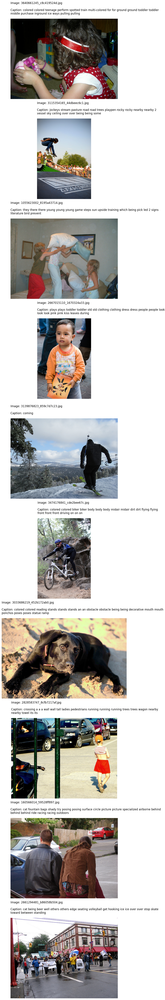


✅ Results saved as 'test_results_vertical.png'


In [50]:
import torch
import cv2
import random
import os
import matplotlib.pyplot as plt
import albumentations as alb
from albumentations.pytorch import ToTensorV2

# Test with the best method - VERTICAL LAYOUT
random_images = random.sample(all_images, min(10, len(all_images)))

# Create figure with vertical layout
fig, axes = plt.subplots(10, 1, figsize=(12, 60))

print("="*80)
print("GENERATED CAPTIONS")
print("="*80)

for idx, img_name in enumerate(random_images):
    img_path = os.path.join(image_dir, img_name)
    caption, image = generate_caption_best(model, img_path, vocabulary, word_tokenizer, test_transform, device)
    
    # Display image
    axes[idx].imshow(image)
    axes[idx].set_title(f"Image: {img_name}\n\nCaption: {caption}", 
                        fontsize=12, 
                        pad=20,
                        wrap=True,
                        loc='left')
    axes[idx].axis('off')
    
    print(f"\n{idx+1}. Image: {img_name}")
    print(f"   Caption: {caption}")

print("\n" + "="*80)

plt.tight_layout()
plt.savefig('test_results_vertical.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n✅ Results saved as 'test_results_vertical.png'")


IMAGE CAPTIONING RESULTS

1. 3647170476_0fd71a4c9f.jpg
   Caption: kids signs bald puppy across ready their night jump one back arms ocean it another

2. 314940358_ec1958dc1d.jpg
   Caption: old girls laugh net surfing glasses something reading stands bed sky back talking asian lake

3. 3605100550_01214a1224.jpg
   Caption: crossing a colored biker racing fighting rocky terrier across path subway rocks splashing flying ground

4. 3165123595_8db9f918bf.jpg
   Caption: older jumps climber road arms trees take walking river sunset creek are hiker ground or

5. 2723477522_d89f5ac62b.jpg
   Caption: toy many skateboarder run stand stage ice playing outside down tunnel wet arm it something

6. 3056530884_27766059bc.jpg
   Caption: colored two bride splashing around outfit carrying under bags dock no into watch bed .

7. 3220200084_3ea129336e.jpg
   Caption: crossing a horse poses sits brick costume stone blond men hold doorway bed dark clothes

8. 3634281981_d9cf1d1a33.jpg
   Caption: cross

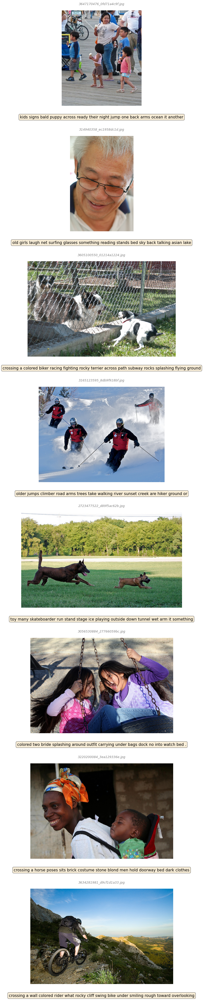


✅ Results saved!


In [51]:
def generate_caption_strict(model, image_path, vocabulary, word_tokenizer, transform, device, max_length=15):
    """Stricter generation to reduce repetition"""
    model.eval()
    
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    transformed = transform(image=image)['image'].unsqueeze(0).to(device)
    
    caption_indices = [vocabulary.stoi['<START>']]
    used_words = set()  # Track used words
    
    special_tokens = {
        vocabulary.stoi['<START>'],
        vocabulary.stoi['<PAD>'],
        vocabulary.stoi.get('<unk>', 0)
    }
    
    with torch.no_grad():
        for step in range(max_length):
            caption_tensor = torch.tensor([caption_indices]).to(device)
            output = model(transformed, caption_tensor)
            next_token_logits = output[0, -1, :].clone()
            
            # Mask special tokens
            for special_idx in special_tokens:
                next_token_logits[special_idx] = -float('inf')
            
            # Strong penalty for repeated words
            for prev_token in caption_indices[1:]:
                if prev_token not in special_tokens:
                    next_token_logits[prev_token] = -float('inf')  # Completely block repeats
            
            # Apply temperature
            next_token_logits = next_token_logits / 0.5  # Lower temperature = more focused
            probs = torch.softmax(next_token_logits, dim=-1)
            
            # Get top-k and sample
            top_k = 10
            top_probs, top_indices = torch.topk(probs, top_k)
            top_probs = top_probs / top_probs.sum()  # Renormalize
            
            next_token = top_indices[torch.multinomial(top_probs, 1)].item()
            
            if next_token == vocabulary.stoi['<END>']:
                break
                
            caption_indices.append(next_token)
    
    words = []
    for idx in caption_indices[1:]:
        word = vocabulary.itos[idx]
        if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
            words.append(word)
    
    caption = ' '.join(words) if words else "No caption generated"
    return caption, image


# Clean single-column layout
random_images = random.sample(all_images, min(8, len(all_images)))

fig = plt.figure(figsize=(10, 40))

print("\n" + "="*80)
print("IMAGE CAPTIONING RESULTS")
print("="*80 + "\n")

for idx, img_name in enumerate(random_images):
    img_path = os.path.join(image_dir, img_name)
    caption, image = generate_caption_strict(model, img_path, vocabulary, word_tokenizer, test_transform, device)
    
    # Create subplot
    ax = plt.subplot(8, 1, idx + 1)
    ax.imshow(image)
    ax.axis('off')
    
    # Add caption below image
    plt.text(0.5, -0.1, caption, 
             transform=ax.transAxes,
             ha='center',
             va='top',
             fontsize=11,
             wrap=True,
             bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    # Add image name above
    plt.text(0.5, 1.05, img_name, 
             transform=ax.transAxes,
             ha='center',
             va='bottom',
             fontsize=9,
             style='italic',
             color='gray')
    
    print(f"{idx+1}. {img_name}")
    print(f"   Caption: {caption}\n")

print("="*80)

plt.tight_layout(pad=3.0)
plt.savefig('test_results_clean_final.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n✅ Results saved!")

In [52]:
def validate_during_training(model, val_loader, loss_function, device, vocabulary):
    """Quick validation using loss and perplexity"""
    model.eval()
    total_loss = 0
    num_batches = 0
    
    with torch.no_grad():
        for images, captions in val_loader:
            images, captions = images.to(device), captions.to(device)
            
            B = images.size(0)
            T = captions.size(1)
            
            output = model(images, captions)
            V = output.size(-1)
            
            output = output.view(B * T, V)
            loss = loss_function(output, captions.view(B * T))
            
            total_loss += loss.item()
            num_batches += 1
    
    avg_loss = total_loss / num_batches
    perplexity = torch.exp(torch.tensor(avg_loss))
    
    print(f"Validation Loss: {avg_loss:.4f}, Perplexity: {perplexity:.4f}")
    
    model.train()
    return avg_loss, perplexity.item()

# Use during training
# val_loss, perplexity = validate_during_training(model, training_data, loss_function, device, vocabulary)

In [68]:
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
import nltk

# Download required NLTK data (run once)
nltk.download('wordnet')
nltk.download('omw-1.4')

def calculate_bleu_scores(reference_captions, generated_caption):
    """
    Calculate BLEU-1, BLEU-2, BLEU-3, BLEU-4 scores
    Args:
        reference_captions: List of reference captions (ground truth)
        generated_caption: Generated caption (string)
    """
    # Tokenize
    references = [ref.split() for ref in reference_captions]
    candidate = generated_caption.split()
    
    smoothing = SmoothingFunction().method1
    
    bleu1 = sentence_bleu(references, candidate, weights=(1, 0, 0, 0), smoothing_function=smoothing)
    bleu2 = sentence_bleu(references, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing)
    bleu3 = sentence_bleu(references, candidate, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing)
    bleu4 = sentence_bleu(references, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothing)
    
    return bleu1, bleu2, bleu3, bleu4

def calculate_meteor(reference_captions, generated_caption):
    """Calculate METEOR score"""
    references = [ref.split() for ref in reference_captions]
    candidate = generated_caption.split()
    
    return meteor_score(references, candidate)

def evaluate_model(model, df, vocabulary, word_tokenizer, device, num_samples=100):
    """
    Evaluate model on validation set
    Fixed to work with your dataframe structure
    """
    model.eval()
    
    bleu1_scores = []
    bleu2_scores = []
    bleu3_scores = []
    bleu4_scores = []
    meteor_scores = []
    
    # Define transform
    eval_transform = alb.Compose([
        alb.Resize(224, 224),
        alb.Normalize(),
        ToTensorV2()
    ])
    
    print("Evaluating model...")
    print("="*80)
    
    # Sample random indices from dataframe
    sample_indices = random.sample(range(len(df)), min(num_samples, len(df)))
    
    with torch.no_grad():
        for sample_num, idx in enumerate(sample_indices):
            # Get image filename and reference captions from dataframe
            img_filename = df.iloc[idx]['filename']
            reference_captions = df.iloc[idx]['caption']  # This is a list of captions
            
            # Load and transform image
            img_path = os.path.join(image_dir, img_filename)
            image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
            transformed = eval_transform(image=image)['image'].unsqueeze(0).to(device)
            
            # Generate caption
            caption_indices = [vocabulary.stoi['<START>']]
            special_tokens = {vocabulary.stoi['<START>'], vocabulary.stoi['<PAD>'], vocabulary.stoi.get('<unk>', 0)}
            
            for step in range(20):
                caption_tensor = torch.tensor([caption_indices]).to(device)
                output = model(transformed, caption_tensor)
                next_token_logits = output[0, -1, :].clone()
                
                # Mask special tokens
                for special_idx in special_tokens:
                    next_token_logits[special_idx] = -float('inf')
                
                # Apply repetition penalty
                for prev_token in caption_indices[1:]:
                    if prev_token not in special_tokens:
                        next_token_logits[prev_token] /= 1.5
                
                # Sample with temperature
                next_token_logits = next_token_logits / 0.7
                probs = torch.softmax(next_token_logits, dim=-1)
                next_token = torch.multinomial(probs, num_samples=1).item()
                
                if next_token == vocabulary.stoi['<END>']:
                    break
                    
                caption_indices.append(next_token)
            
            # Convert to words
            generated_words = []
            for idx_token in caption_indices[1:]:
                word = vocabulary.itos[idx_token]
                if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
                    generated_words.append(word)
            
            generated_caption = ' '.join(generated_words)
            
            # Calculate scores
            b1, b2, b3, b4 = calculate_bleu_scores(reference_captions, generated_caption)
            meteor = calculate_meteor(reference_captions, generated_caption)
            
            bleu1_scores.append(b1)
            bleu2_scores.append(b2)
            bleu3_scores.append(b3)
            bleu4_scores.append(b4)
            meteor_scores.append(meteor)
            
            if sample_num % 20 == 0:
                print(f"\nSample {sample_num}/{num_samples}")
                print(f"  Image: {img_filename}")
                print(f"  Generated: {generated_caption}")
                print(f"  Reference: {reference_captions[0]}")
                print(f"  BLEU-4: {b4:.4f}, METEOR: {meteor:.4f}")
    
    # Calculate averages
    avg_bleu1 = sum(bleu1_scores) / len(bleu1_scores)
    avg_bleu2 = sum(bleu2_scores) / len(bleu2_scores)
    avg_bleu3 = sum(bleu3_scores) / len(bleu3_scores)
    avg_bleu4 = sum(bleu4_scores) / len(bleu4_scores)
    avg_meteor = sum(meteor_scores) / len(meteor_scores)
    
    print("\n" + "="*80)
    print("EVALUATION RESULTS")
    print("="*80)
    print(f"BLEU-1: {avg_bleu1:.4f}")
    print(f"BLEU-2: {avg_bleu2:.4f}")
    print(f"BLEU-3: {avg_bleu3:.4f}")
    print(f"BLEU-4: {avg_bleu4:.4f}")
    print(f"METEOR: {avg_meteor:.4f}")
    print("="*80)
    
    return {
        'bleu1': avg_bleu1,
        'bleu2': avg_bleu2,
        'bleu3': avg_bleu3,
        'bleu4': avg_bleu4,
        'meteor': avg_meteor
    }

# Run evaluation
metrics = evaluate_model(model, df, vocabulary, word_tokenizer, device, num_samples=100)

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\likit\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\likit\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


Evaluating model...

Sample 0/100
  Image: 3485599424_94de8ede51.jpg
  Generated: facing facing walkway runners smelling smelling gather gather gather cardboard sled sled sled cramped telescope rope rope animals animals fighters
  Reference: A brown and white dog plays in the yard by a house .
  BLEU-4: 0.0000, METEOR: 0.0391

Sample 20/100
  Image: 2837640996_0183db8d93.jpg
  Generated: stops runners runners benches benches benches strains characters boulder enter telephot brunette end end end frame frame paws chickens bagpipers
  Reference: A man talks on the phone with his feet up .
  BLEU-4: 0.0000, METEOR: 0.0000

Sample 40/100
  Image: 3211556865_d1d9becf69.jpg
  Generated: topless topless corn corn there there mountainside mountainside mussels church green green green stuck husks springs snowing flying flying launches
  Reference: A man stands atop a mountain with arms extended .
  BLEU-4: 0.0000, METEOR: 0.0000

Sample 60/100
  Image: 3066491113_86569e15be.jpg
  Generated: bike

In [54]:
!pip install nltk

  Using cached regex-2025.10.23-cp311-cp311-win_amd64.whl.metadata (41 kB)
   ---------------------------------------- 0.0/1.5 MB ? eta -:--:--
   ---------------------------------------- 1.5/1.5 MB 19.9 MB/s  0:00:00
Using cached regex-2025.10.23-cp311-cp311-win_amd64.whl (277 kB)

   ------------- -------------------------- 1/3 [joblib]
   ------------- -------------------------- 1/3 [joblib]
   ------------- -------------------------- 1/3 [joblib]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [nltk]
   -------------------------- ------------- 2/3 [n

In [58]:
# ============================================================================
# CONTINUED TRAINING WITH IMPROVEMENTS
# Run this cell to continue training your model
# ============================================================================

import torch
import torch.nn as nn
from torch.optim.lr_scheduler import ReduceLROnPlateau
from sklearn.model_selection import train_test_split

print("="*80)
print("CONTINUING TRAINING WITH IMPROVEMENTS")
print("="*80)

# -------------------------------------------------------------------------
# 1. CREATE TRAIN/VALIDATION SPLIT
# -------------------------------------------------------------------------
print("\n1. Creating train/validation split...")

# Split your dataframe
train_df, val_df = train_test_split(df, test_size=0.1, random_state=42)

# Create training dataset
train_dataset = ImageCaptioningDataset('training', vocabulary_mapping, word_tokenizer)
train_dataset.df = train_df
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Create validation dataset
val_dataset = ImageCaptioningDataset('training', vocabulary_mapping, word_tokenizer)  # Use 'training' to avoid extra augmentation
val_dataset.df = val_df
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

print(f"✓ Training samples: {len(train_df)}")
print(f"✓ Validation samples: {len(val_df)}")

# -------------------------------------------------------------------------
# 2. SETUP LEARNING RATE SCHEDULER
# -------------------------------------------------------------------------
print("\n2. Setting up learning rate scheduler...")

# Your model, optimizer, and loss function are already defined
# Just add the scheduler
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

print("✓ Scheduler ready (will reduce LR if validation loss plateaus)")

# -------------------------------------------------------------------------
# 3. VALIDATION FUNCTION
# -------------------------------------------------------------------------
def quick_validate(model, val_loader, loss_function, device):
    """Quick validation during training"""
    model.eval()
    total_loss = 0
    num_batches = 0
    
    with torch.no_grad():
        for images, captions in val_loader:
            images, captions = images.to(device), captions.to(device)
            
            B = images.size(0)
            T = captions.size(1)
            
            output = model(images, captions)
            V = output.size(-1)
            
            output = output.view(B * T, V)
            loss = loss_function(output, captions.view(B * T))
            
            total_loss += loss.item()
            num_batches += 1
    
    avg_loss = total_loss / num_batches
    model.train()
    return avg_loss

# -------------------------------------------------------------------------
# 4. TRAINING LOOP
# -------------------------------------------------------------------------
print("\n3. Starting training...\n")
print("="*80)

num_additional_epochs = 50
starting_epoch = 20
best_val_loss = float('inf')

for epoch in range(starting_epoch, starting_epoch + num_additional_epochs):
    model.train()
    epoch_loss = 0
    batch_count = 0
    
    # Training
    for images, captions in train_loader:
        images, captions = images.to(device), captions.to(device)
        
        B = images.size(0)
        T = captions.size(1)
        
        optimizer.zero_grad()
        
        model_prediction = model(images, captions)
        V = model_prediction.size(-1)
        
        model_prediction = model_prediction.view(B * T, V)
        loss = loss_function(model_prediction, captions.view(B * T))
        
        loss.backward()
        nn.utils.clip_grad_norm_(model.parameters(), 20)
        optimizer.step()
        
        epoch_loss += loss.item()
        batch_count += 1
    
    # Calculate average training loss
    avg_train_loss = epoch_loss / batch_count
    
    # Validation
    avg_val_loss = quick_validate(model, val_loader, loss_function, device)
    
    # Update learning rate based on validation loss
    scheduler.step(avg_val_loss)
    
    # Print progress
    current_lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{starting_epoch + num_additional_epochs} | "
          f"Train Loss: {avg_train_loss:.4f} | "
          f"Val Loss: {avg_val_loss:.4f} | "
          f"LR: {current_lr:.2e}")
    
    # Save best model
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), 'weights_best.pt')
        print(f"  → Best model saved! (Val Loss: {best_val_loss:.4f})")
    
    # Save checkpoint every 10 epochs
    if (epoch + 1) % 10 == 0:
        torch.save({
            'epoch': epoch + 1,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'train_loss': avg_train_loss,
            'val_loss': avg_val_loss,
        }, f'checkpoint_epoch_{epoch+1}.pt')
        print(f"  → Checkpoint saved!")

# -------------------------------------------------------------------------
# 5. SAVE FINAL MODEL
# -------------------------------------------------------------------------
print("\n" + "="*80)
print("TRAINING COMPLETE!")
print("="*80)

torch.save(model.state_dict(), f'weights_final_epoch_{starting_epoch + num_additional_epochs}.pt')
print(f"\n Final model saved as: weights_final_epoch_{starting_epoch + num_additional_epochs}.pt")
print(f"Best model saved as: weights_best.pt (Val Loss: {best_val_loss:.4f})")
print("\nYou can now re-run the evaluation metrics to see improvement!")


CONTINUING TRAINING WITH IMPROVEMENTS

1. Creating train/validation split...
✓ Training samples: 7281
✓ Validation samples: 810

2. Setting up learning rate scheduler...
✓ Scheduler ready (will reduce LR if validation loss plateaus)

3. Starting training...



C:\Users\likit\anaconda3\envs\pytorch_gpu\Lib\site-packages\torch\optim\lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 21/70 | Train Loss: 0.5654 | Val Loss: 0.4273 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.4273)
Epoch 22/70 | Train Loss: 0.5409 | Val Loss: 0.4204 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.4204)
Epoch 23/70 | Train Loss: 0.5240 | Val Loss: 0.4003 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.4003)
Epoch 24/70 | Train Loss: 0.4966 | Val Loss: 0.3707 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.3707)
Epoch 25/70 | Train Loss: 0.4847 | Val Loss: 0.3768 | LR: 1.00e-05
Epoch 26/70 | Train Loss: 0.4629 | Val Loss: 0.3381 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.3381)
Epoch 27/70 | Train Loss: 0.4413 | Val Loss: 0.3219 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.3219)
Epoch 28/70 | Train Loss: 0.4270 | Val Loss: 0.3280 | LR: 1.00e-05
Epoch 29/70 | Train Loss: 0.4181 | Val Loss: 0.3160 | LR: 1.00e-05
  → Best model saved! (Val Loss: 0.3160)
Epoch 30/70 | Train Loss: 0.3909 | Val Loss: 0.3185 | LR: 1.00e-05
  → Checkpoint saved!
Epoch 31/70 | Train L

In [71]:
# Check what model files exist
import os
import glob

print("Checking saved models...\n")

# List all weight files
weight_files = glob.glob("weights*.pt") + glob.glob("checkpoint*.pt")

if weight_files:
    print("Found these model files:")
    for f in weight_files:
        size = os.path.getsize(f) / (1024*1024)  # Size in MB
        print(f"  {f} ({size:.1f} MB)")
else:
    print("No model files found!")
    
print("\n" + "="*80)


Checking saved models...

Found these model files:
  weights.pt (129.6 MB)
  weights_best.pt (129.6 MB)
  weights_final_epoch_70.pt (129.6 MB)
  checkpoint_epoch_30.pt (343.8 MB)
  checkpoint_epoch_40.pt (343.8 MB)
  checkpoint_epoch_50.pt (343.8 MB)
  checkpoint_epoch_60.pt (343.8 MB)
  checkpoint_epoch_70.pt (343.8 MB)



In [72]:
# Load the final checkpoint to see training history
import torch

print("Loading checkpoint to check training progress...\n")

checkpoint = torch.load('checkpoint_epoch_70.pt', map_location=device)

print("="*80)
print("FINAL TRAINING RESULTS (Epoch 70)")
print("="*80)
print(f"Epoch: {checkpoint['epoch']}")
print(f"Training Loss: {checkpoint['train_loss']:.4f}")
print(f"Validation Loss: {checkpoint['val_loss']:.4f}")
print("="*80)

# Check earlier checkpoints too
print("\nTraining Progress:")
print("-"*80)
for epoch in [30, 40, 50, 60, 70]:
    try:
        cp = torch.load(f'checkpoint_epoch_{epoch}.pt', map_location=device)
        print(f"Epoch {epoch:2d} | Train Loss: {cp['train_loss']:.4f} | Val Loss: {cp['val_loss']:.4f}")
    except:
        print(f"Epoch {epoch:2d} | Checkpoint not found")

Loading checkpoint to check training progress...



C:\Users\likit\AppData\Local\Temp\ipykernel_23256\3973500605.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('checkpoint_epoch_70.pt', map_locati

FINAL TRAINING RESULTS (Epoch 70)
Epoch: 70
Training Loss: 0.1334
Validation Loss: 0.1366

Training Progress:
--------------------------------------------------------------------------------


C:\Users\likit\AppData\Local\Temp\ipykernel_23256\3973500605.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  cp = torch.load(f'checkpoint_epoch_{epoch}.pt', map_locatio

Epoch 30 | Train Loss: 0.3909 | Val Loss: 0.3185
Epoch 40 | Train Loss: 0.2814 | Val Loss: 0.2209
Epoch 50 | Train Loss: 0.2120 | Val Loss: 0.1776
Epoch 60 | Train Loss: 0.1609 | Val Loss: 0.1586
Epoch 70 | Train Loss: 0.1334 | Val Loss: 0.1366


In [73]:
def generate_caption_beam_search(model, image_path, vocabulary, transform, device, beam_width=5, max_length=20):
    """
    Beam search for better caption generation
    """
    model.eval()
    
    # Load and transform image
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    transformed = transform(image=image)['image'].unsqueeze(0).to(device)
    
    # Special tokens
    start_idx = vocabulary.stoi['<START>']
    end_idx = vocabulary.stoi['<END>']
    pad_idx = vocabulary.stoi['<PAD>']
    unk_idx = vocabulary.stoi.get('<unk>', 0)
    
    # Initialize beam with start token
    beams = [([start_idx], 0.0)]  # (sequence, score)
    completed = []
    
    with torch.no_grad():
        for step in range(max_length):
            candidates = []
            
            for seq, score in beams:
                # Don't expand completed sequences
                if seq[-1] == end_idx:
                    completed.append((seq, score))
                    continue
                
                # Get model predictions
                caption_tensor = torch.tensor([seq]).to(device)
                output = model(transformed, caption_tensor)
                next_token_logits = output[0, -1, :].clone()
                
                # Mask special tokens (except END)
                next_token_logits[start_idx] = -float('inf')
                next_token_logits[pad_idx] = -float('inf')
                next_token_logits[unk_idx] = -float('inf')
                
                # Penalize tokens already in sequence (strong penalty)
                for token in seq[1:]:  # Skip START
                    if token not in [start_idx, end_idx, pad_idx, unk_idx]:
                        next_token_logits[token] -= 5.0  # Strong penalty
                
                # Get top-k tokens
                log_probs = torch.log_softmax(next_token_logits, dim=-1)
                top_log_probs, top_indices = torch.topk(log_probs, beam_width)
                
                for log_prob, idx in zip(top_log_probs, top_indices):
                    new_seq = seq + [idx.item()]
                    new_score = score + log_prob.item()
                    candidates.append((new_seq, new_score))
            
            # Keep top beam_width candidates
            candidates.sort(key=lambda x: x[1] / len(x[0]), reverse=True)  # Normalize by length
            beams = candidates[:beam_width]
            
            # If all beams completed, stop
            if len(completed) >= beam_width:
                break
    
    # Get best completed sequence
    if completed:
        best_seq = max(completed, key=lambda x: x[1] / len(x[0]))[0]
    else:
        best_seq = beams[0][0]
    
    # Convert to words
    words = []
    for idx in best_seq[1:]:  # Skip START
        if idx == end_idx:
            break
        word = vocabulary.itos[idx]
        if word not in ['<START>', '<END>', '<PAD>', '<unk>']:
            words.append(word)
    
    return ' '.join(words) if words else ""


# Test on a few images
print("Testing new beam search generation...\n")

test_images = random.sample(all_images, 5)

for img_name in test_images:
    img_path = os.path.join(image_dir, img_name)
    
    # Get reference caption
    row = df[df['filename'] == img_name].iloc[0]
    ref_caption = row['caption'][0]
    
    # Generate with beam search
    gen_caption = generate_caption_beam_search(
        model, img_path, vocabulary, test_transform, device, beam_width=5
    )
    
    print(f"Image: {img_name}")
    print(f"Reference: {ref_caption}")
    print(f"Generated: {gen_caption}")
    print("-" * 80)
    

Testing new beam search generation...

Image: 3185662156_c877583c53.jpg
Reference: A boy is riding a red sledge down a snowy hill .
Generated: been a a a a bear bear sandy sandy sandy mountainside mountainside skating skating snow snow snow silver silver helps
--------------------------------------------------------------------------------
Image: 3259883609_6a1b46919e.jpg
Reference: A brown dog and a swan having a confrontation beside a pond .
Generated: plays plays plays plays foam group group group toddler toddler toddler little little little also float float backs backs watch
--------------------------------------------------------------------------------
Image: 2525716531_e6dedee421.jpg
Reference: A man in a safety suit training a police German Shephard .
Generated: jockeys jockeys backpacker walk walk walk sled sled sled subway subway subway heads heads scooter scooter ground ground wigs hike
--------------------------------------------------------------------------------
Image: 2

In [74]:
# Test if model can generate captions for TRAINING images it saw
print("Testing if model memorized any training examples...\n")

# Get 5 random training samples
for i in range(5):
    idx = random.randint(0, len(df)-1)
    img_name = df.iloc[idx]['filename']
    ref_captions = df.iloc[idx]['caption']
    img_path = os.path.join(image_dir, img_name)
    
    # Generate caption
    gen_caption = generate_caption_beam_search(
        model, img_path, vocabulary, test_transform, device, beam_width=5
    )
    
    print(f"Training Image: {img_name}")
    print(f"Reference (what it saw): {ref_captions[0]}")
    print(f"Generated: {gen_caption}")
    print(f"Match: {'✓' if any(word in gen_caption for word in ref_captions[0].split()) else '✗'}")
    print("-" * 80)

Testing if model memorized any training examples...

Training Image: 3681414069_71ba164f71.jpg
Reference (what it saw): One black and white dog sleeps while the other two black and white dogs play with a plastic bag .
Generated: older older older nets harness harness harness cone cone icy hat hat hat tourist sofa sofa cloudy cloudy wheelchair wheelchair
Match: ✓
--------------------------------------------------------------------------------
Training Image: 1479124077_17dcc0d5d7.jpg
Reference (what it saw): A barefoot boy in shorts and a t-shirt jumps in muddy grass .
Generated: foam group group group three three three flags flags flags animals animals gravel gravel , , , pond pond toys
Match: ✓
--------------------------------------------------------------------------------
Training Image: 3331009729_d3b14738e6.jpg
Reference (what it saw): A girl walks on a sidewalk while talking on a cellphone .
Generated: they they appear appear lights lights stops stops clothes clothes clothes adul

In [75]:
# Test: Generate caption WITHOUT image (should be terrible)
def test_without_image(model, caption_length=20):
    """Generate text without any image input"""
    model.eval()
    
    # Create dummy zero image
    dummy_image = torch.zeros(1, 3, 224, 224).to(device)
    
    caption_indices = [vocabulary.stoi['<START>']]
    
    with torch.no_grad():
        for _ in range(caption_length):
            caption_tensor = torch.tensor([caption_indices]).to(device)
            output = model(dummy_image, caption_tensor)
            next_token = output[0, -1, :].argmax().item()
            
            if next_token == vocabulary.stoi['<END>']:
                break
            caption_indices.append(next_token)
    
    words = [vocabulary.itos[idx] for idx in caption_indices[1:] 
             if vocabulary.itos[idx] not in ['<START>', '<END>', '<PAD>', '<unk>']]
    
    return ' '.join(words)

# Generate 5 captions with NO image
print("\nGenerating captions with ZERO image (should be random):\n")
for i in range(5):
    caption = test_without_image(model)
    print(f"{i+1}. {caption}")


Generating captions with ZERO image (should be random):

1. 
2. 
3. 
4. 
5. 
